In [2]:
import pandas as pd
import numpy as np
import statsmodels.api as sm
import statsmodels.formula.api as smf
import patsy
import datetime
import seaborn as sns
import matplotlib.pyplot as plt
import missingno as msno
import pandas_profiling as pp


# Collecting Data

## Column Definition


airline  :	Airline IATA code  
flightno :	Flight number  
origin   :	Originating airport code  
dest     : Destination airport code  
totalseatcount : 	Total seats available on the flight  
generalacft  :	Aircraft type  
depgate  :	Departure (originating) airport gate  
arrgate  :	Arrival (destination) airport gate  
scheduled_departure_dttm  :	Scheduled local date and time of departure  
scheduled_arrival_dttm  :	Scheduled local date and time of arrival  
actual_departure_dttm  :	Actual local date and time of departure  
actual_arrival_dttm  :	Actual local date and time of arrival  
airtime  :	En route flight time in minutes  
taxiout  :	Taxi out time in minutes  
taxiin   :	Taxi in time in minutes  
depvariance  :	Variance (in minutes) between actual and scheduled departure time  
arrvariance  :	Variance (in minutes) between actual and scheduled arrival time  
internationalflag : 	1 = international flight, 0 = domestic flight  


In [3]:
flights=pd.read_csv(r'C:/Users/cutem/OneDrive/Desktop/Maithili/MS_Code/Allaska/flight_data_SAN.csv')
weather =pd.read_csv(r'C:/Users/cutem/OneDrive/Desktop/Maithili/MS_Code/Allaska/weather_data.csv')
#weather.head()

In [488]:
flights['scheduled_departure'] =  pd.to_datetime(flights['scheduled_departure_dttm'], format='%Y-%m-%dT%H:%M:%S')
flights['scheduled_departure'] = pd.to_datetime(flights['scheduled_departure_dttm'])
weather['DATE'] = pd.to_datetime(weather['DATE'])

In [489]:
def get_daypart(time):
    start_times = ["05:00", "08:00", "12:00", "17:00", "21:00"]
    end_times = ["08:00", "12:00", "17:00", "21:00", "05:00"]
    day_part_list = ["Early Morning", "Morning", "Afternoon", "Evening", "Night"]
    
    for index, hour in enumerate(start_times):        
        first_time = datetime.datetime.strptime(hour,"%H:%M")
        second_time = datetime.datetime.strptime(end_times[index],"%H:%M")
        
        if time.time() >= first_time.time() and time.time() < second_time.time():
            return day_part_list[index]      
        elif index == 4:
            return day_part_list[index]

def get_day(date):    
    num = date.to_pydatetime().weekday()
    day_dict = {0 : 'Mon', 1 : 'Tues', 2 : 'Wed', 3 : 'Thurs', 4 : 'Fri', 5 : 'Sat', 6 : 'Sun'}
    return day_dict[num]

def get_month(date): 
    month_dict = {1 : 'Jan',2:'Feb',3:'March', 4 : 'Apr',5:'May', 6 : 'Jun',7:'July',8:'Aug',9:'Sep', 10 : 'Oct',11:'Nov',12:'Dec'}
    num = date.to_pydatetime().month
    return month_dict[num]

In [490]:
flights['DayOfWeek'] = flights['scheduled_departure'].apply(lambda row: get_day(row))
flights['Month'] = flights['scheduled_departure'].apply(lambda row: get_month(row))
flights['DayPart'] = flights['scheduled_departure'].apply(lambda row: get_daypart(row))

In [491]:
flights['DATE'] = pd.DatetimeIndex(flights['scheduled_departure_dttm']).date
flights.sort_values(by=['DATE'], inplace=True)

flights['DATE'] = flights.DATE.astype(str)
weather['DATE'] = weather.DATE.astype(str)

In [492]:
weather.set_index('DATE')
flights.set_index('DATE')
combined_data1 = pd.merge(flights, weather, on = "DATE", how = "left")

In [493]:
flights.airline.unique()

airline_dict = {'code':['WN', 'AS', 'HA', 'NK', 'UA', 'AA', 'VX', 'B6', 'DL', 'WS', 'F9','SY', 'AC', 'G4']
                ,'names':['Southwest','Alaska','Hawaiian','Spirit','United','American','Virgin America','Jetblue','Delta','West Jet','Frontier','MN','Air Canada','Allegiant']
                  }
airline_dict_df = pd.DataFrame(airline_dict)
airline_dict_df

,code,names
0,WN,Southwest
1,AS,Alaska
2,HA,Hawaiian
3,NK,Spirit
4,UA,United
5,AA,American
6,VX,Virgin America
7,B6,Jetblue
8,DL,Delta
9,WS,West Jet


In [494]:
#combined_data1.info()

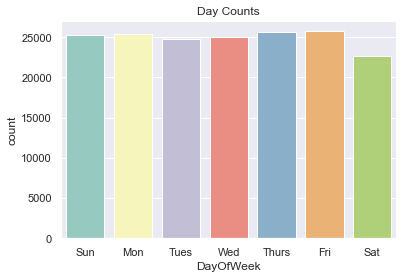

In [497]:
ax = sns.countplot(x="DayOfWeek", data=data,palette="Set3")
ax.set_title('Day Counts');

In [518]:
data = combined_data1.drop(columns=['origin','scheduled_departure_dttm','scheduled_arrival_dttm', 'actual_departure_dttm',
       'actual_arrival_dttm','internationalflag','Fof/ice','heavy Fog/freezing fog','Smoke','Thunder','origin','Peak gust timeTM'])
#data.head()

In [519]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 188525 entries, 0 to 188524
Data columns (total 26 columns):
 #   Column                               Non-Null Count   Dtype         
---  ------                               --------------   -----         
 0   airline                              188525 non-null  object        
 1   flightno                             188525 non-null  int64         
 2   dest                                 188525 non-null  object        
 3   totalseatcount                       188525 non-null  int64         
 4   generalacft                          188363 non-null  object        
 5   depgate                              185087 non-null  object        
 6   arrgate                              182204 non-null  object        
 7   airtime                              187259 non-null  float64       
 8   taxiout                              187413 non-null  float64       
 9   taxiin                               186931 non-null  float64       
 

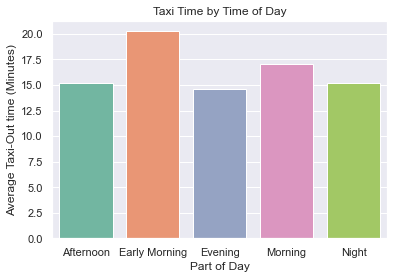

In [520]:
week_grouped = data.groupby(['DayPart'])['taxiout'].mean()

week_grouped = week_grouped.reset_index()

ax = sns.barplot(x='DayPart', y='taxiout', data=week_grouped, palette="Set2")

ax.set_title('Taxi Time by Time of Day')
ax.set_xlabel('Part of Day')
ax.set_ylabel('Average Taxi-Out time (Minutes)');

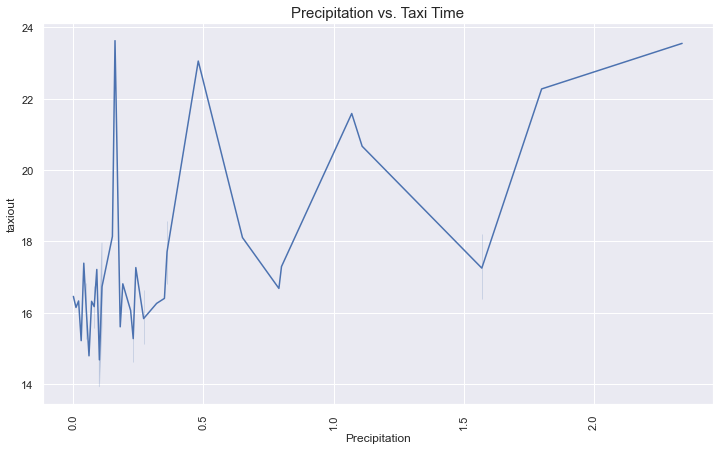

In [521]:
fig, ax = plt.subplots(figsize=(12,7)) 
sns.lineplot(x='Precipitation', y='taxiout', data=data)
plt.xticks(rotation=90);
plt.title("Precipitation vs. Taxi Time", size=15);
plt.savefig('Precipitation', bbox_inches ='tight', dpi = 400)

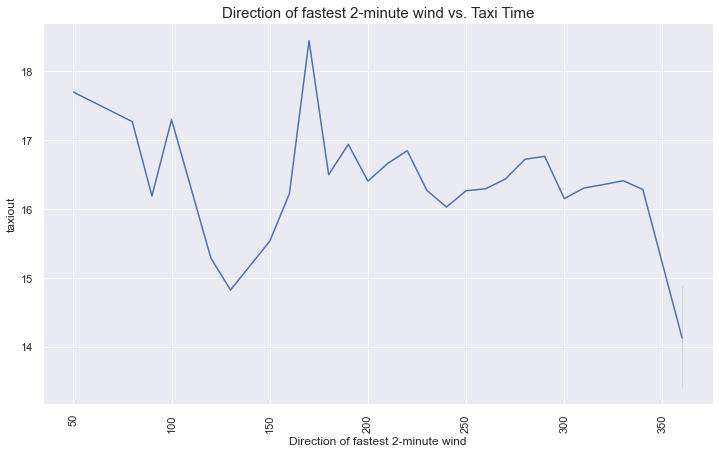

In [522]:
fig, ax = plt.subplots(figsize=(12,7)) 
sns.lineplot(x='Direction of fastest 2-minute wind', y='taxiout', data=data)
plt.xticks(rotation=90);
plt.title("Direction of fastest 2-minute wind vs. Taxi Time", size=15);
plt.savefig('Direction of fastest 2-minute wind', bbox_inches ='tight', dpi = 400)

In [523]:
data.isnull().sum()
data = data.dropna()
data = data.drop_duplicates()

IQR is 8.0
upper_lim is 32.0
lower_lim is 0.0
airtime mean 16.54116184284623


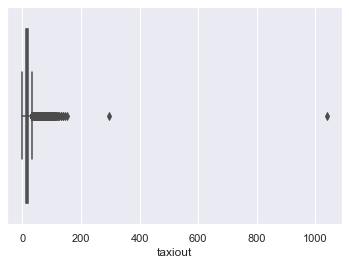

In [524]:
Q1 = data['taxiout'].quantile(0.25)
Q3 = data['taxiout'].quantile(0.75)
IQR = Q3 - Q1
upper_lim = Q3 + 1.5*(IQR)
lower_lim = Q1 - 1.5*(IQR)
print("IQR is",IQR)
print("upper_lim is",upper_lim)
print("lower_lim is",lower_lim)


x = data['taxiout'].mean()


print("airtime mean",x)

ax = sns.boxplot(x=data["taxiout"])
plt.show()

In [525]:
index1 = data[ (data['taxiout'] > upper_lim) ].index
data_out = data.drop(index1 , inplace=True)


IQR is 7.0
upper_lim is 29.5
lower_lim is 1.5
airtime mean 15.805231374483142


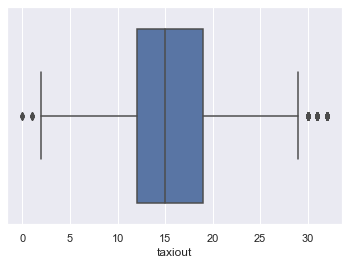

In [526]:
Q1 = data['taxiout'].quantile(0.25)
Q3 = data['taxiout'].quantile(0.75)
IQR = Q3 - Q1
upper_lim = Q3 + 1.5*(IQR)
lower_lim = Q1 - 1.5*(IQR)
print("IQR is",IQR)
print("upper_lim is",upper_lim)
print("lower_lim is",lower_lim)
x = data['taxiout'].mean()
print("airtime mean",x)
ax = sns.boxplot(x=data["taxiout"])
plt.show()

Text(0.5, 1.0, 'Distribution of Taxi-Out Time')

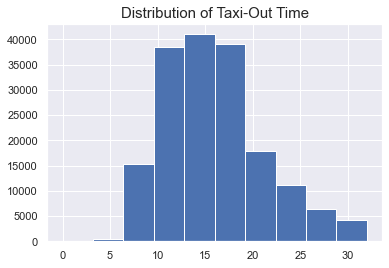

In [527]:
y = data['taxiout']
y.hist();
plt.title('Distribution of Taxi-Out Time', size=15)

In [528]:
profile = pp.ProfileReport(data, title='Pandas Profiling Report', explorative=True)
#profile

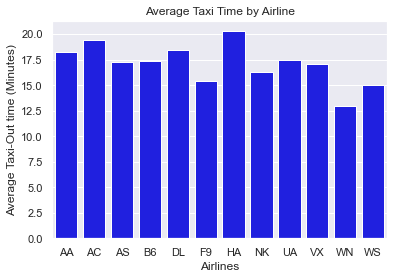

In [565]:
airline_grouped = data.groupby(['airline'])['taxiout'].mean()
airline_grouped = airline_grouped.reset_index()
ax = sns.barplot(x='airline', y='taxiout', data=airline_grouped, color='Blue')
ax.set_title('Average Taxi Time by Airline');
ax.set_ylabel('Average Taxi-Out time (Minutes)')
ax.set_xlabel('Airlines');

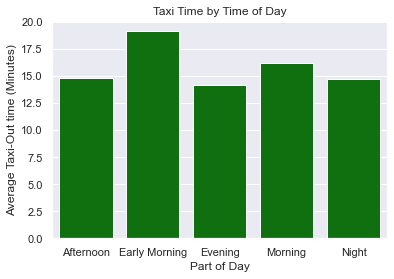

In [540]:
Day_part_grouped = data.groupby(['DayPart'])['taxiout'].mean()

Day_part_grouped = Day_part_grouped.reset_index()

ax = sns.barplot(x='DayPart', y='taxiout', data=Day_part_grouped, color='green')

ax.set_title('Taxi Time by Time of Day')
ax.set_xlabel('Part of Day')
ax.set_ylabel('Average Taxi-Out time (Minutes)');

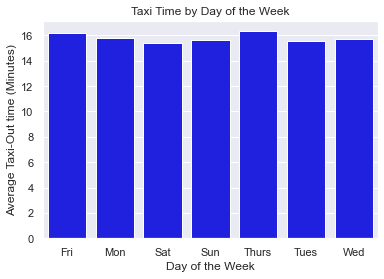

In [542]:
week_grouped = data.groupby(['DayOfWeek'])['taxiout'].mean()

week_grouped = week_grouped.reset_index()

ax = sns.barplot(x='DayOfWeek', y='taxiout', data=week_grouped, color='blue')

ax.set_title('Taxi Time by Day of the Week')
ax.set_xlabel('Day of the Week')
ax.set_ylabel('Average Taxi-Out time (Minutes)');

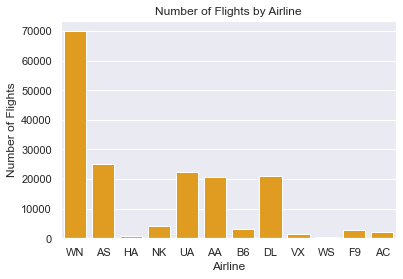

In [546]:
airline_names = airline_dict_df.names
data['airline'].value_counts()

ax = sns.countplot(x="airline", data=data, color='Orange')
ax.set_title('Number of Flights by Airline');
ax.set_xlabel('Airline')
ax.set_ylabel('Number of Flights');

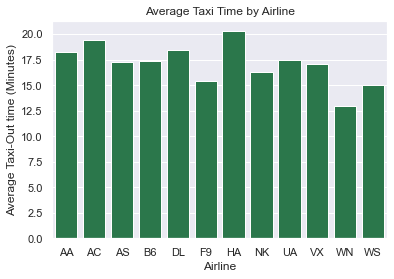

In [547]:
airline_grouped = data.groupby(['airline'])['taxiout'].mean()

airline_grouped = airline_grouped.reset_index()
ax = sns.barplot(x='airline', y='taxiout', data=airline_grouped, color='#1E8449');
ax.set_xlabel('Airline')
ax.set_ylabel('Average Taxi-Out time (Minutes)')
ax.set_title('Average Taxi Time by Airline');


In [548]:
data_f = data

In [438]:
data.to_excel(r'C:/Users/cutem/OneDrive/Desktop/Maithili/MS_Code/Allaska/Final_tableau_data.xlsx', index = False, header=True)

In [392]:
data_f.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174371 entries, 0 to 188524
Data columns (total 26 columns):
 #   Column                               Non-Null Count   Dtype         
---  ------                               --------------   -----         
 0   airline                              174371 non-null  object        
 1   flightno                             174371 non-null  int64         
 2   dest                                 174371 non-null  object        
 3   totalseatcount                       174371 non-null  int64         
 4   generalacft                          174371 non-null  object        
 5   depgate                              174371 non-null  object        
 6   arrgate                              174371 non-null  object        
 7   airtime                              174371 non-null  float64       
 8   taxiout                              174371 non-null  float64       
 9   taxiin                               174371 non-null  float64       
 

In [549]:
data_f = pd.get_dummies(data=data_f, columns=['dest','depgate','generalacft','airline','DayOfWeek','Month','DayPart'], drop_first=True)

In [394]:
data_f.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 174371 entries, 0 to 188524
Columns: 214 entries, flightno to DayPart_Night
dtypes: datetime64[ns](1), float64(10), int64(6), object(2), uint8(195)
memory usage: 59.0+ MB


In [550]:
for  col in  data_f.columns:
    data_f[col] = pd.to_numeric(data_f[col], errors='coerce')


In [551]:
data_f = data_f.drop(columns=['DATE'])

In [552]:
data_f.head()

,flightno,totalseatcount,arrgate,airtime,taxiout,taxiin,depvariance,arrvariance,scheduled_departure,Average wind speed,...,Month_Jun,Month_March,Month_May,Month_Nov,Month_Oct,Month_Sep,DayPart_Early Morning,DayPart_Evening,DayPart_Morning,DayPart_Night
0,658,143,24.0,67.0,9.0,3.0,-7.0,-13.0,1483281000000000000,5.37,...,0,0,0,0,0,0,0,0,0,0
1,481,181,NaN,155.0,14.0,11.0,-1.0,-1.0,1483264800000000000,5.37,...,0,0,0,0,0,0,0,0,1,0
2,493,181,NaN,165.0,19.0,24.0,28.0,61.0,1483257900000000000,5.37,...,0,0,0,0,0,0,0,0,1,0
3,717,157,NaN,83.0,12.0,6.0,200.0,187.0,1483304700000000000,5.37,...,0,0,0,0,0,0,0,0,0,1
4,3410,78,26.0,73.0,15.0,4.0,-16.0,-6.0,1483293600000000000,5.37,...,0,0,0,0,0,0,0,1,0,0


In [553]:
data_f2 = data_f.dropna()

In [554]:
data_f2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 48927 entries, 0 to 188524
Columns: 213 entries, flightno to DayPart_Night
dtypes: float64(11), int64(7), uint8(195)
memory usage: 16.2 MB


In [555]:
x = data_f2.drop(columns=['taxiout']) 

y = data_f2['taxiout']

In [556]:
X_train, x_test, Y_train, y_test = train_test_split(x1, y, test_size = 0.2, random_state = 0)

In [557]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.preprocessing import StandardScaler
from sklearn import linear_model
from sklearn.metrics import mean_squared_error, r2_score

In [558]:
std = StandardScaler() 
std.fit(X_train.values) 
X_train_scaled = std.transform(X_train.values)
model = sm.OLS(Y_train, sm.add_constant(X_train_scaled))

fit1 = model.fit()
fit1.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                taxiout   R-squared:                       0.616
Model:                            OLS   Adj. R-squared:                  0.615
Method:                 Least Squares   F-statistic:                     423.0
Date:                Thu, 10 Dec 2020   Prob (F-statistic):               0.00
Time:                        23:26:53   Log-Likelihood:            -1.0278e+05
No. Observations:               39141   AIC:                         2.059e+05
Df Residuals:                   38992   BIC:                         2.071e+05
Df Model:                         148                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         15.1878      0.017    897.034      0.000      15.155      15.221
x1             0.0249      0.024      1.025      0.306      -0.023       0.072
x2             0.0994      0.063      1.576      0.115      -0.024       0.223
x3            -0.1641      0.059     -2.790      0.005      -0.279      -0.049
x4           -27.6835      0.250   -110.815      0.000     -28.173     -27.194
x5            -2.6480      0.023   -113.031      0.000      -2.694      -2.602
x6           -15.5789      0.094   -165.862      0.000     -15.763     -15.395
x7            16.4817      0.096    170.935      0.000      16.293      16.671
x8             0.4978      0.021     23.394      0.000       0.456       0.540
x9             0.0116      0.036      0.319      0.750      -0.060       0.083
x10            0.1280      0.020      6.319      0.000       0.088       0.168
x11            0.0159      0.098      0.162      0.871      -0.177       0.208
x12            0.0386      0.055      0.703      0.482      -0.069       0.146
x13           -0.1436      0.070     -2.057      0.040      -0.280      -0.007
x14           -0.0460      0.036     -1.278      0.201      -0.116       0.025
x15            0.0832      0.035      2.344      0.019       0.014       0.153
x16            0.0422      0.063      0.669      0.504      -0.081       0.166
x17           -0.1283      0.063     -2.042      0.041      -0.252      -0.005
x18        -1.838e-13   1.56e-15   -118.176      0.000   -1.87e-13   -1.81e-13
x19            1.9033      0.026     74.435      0.000       1.853       1.953
x20        -1.164e-13    9.5e-16   -122.490      0.000   -1.18e-13   -1.15e-13
x21         1.165e-13   9.67e-16    120.488      0.000    1.15e-13    1.18e-13
x22         9.013e-14   7.37e-16    122.277      0.000    8.87e-14    9.16e-14
x23         1.486e-14    1.1e-16    135.721      0.000    1.46e-14    1.51e-14
x24        -3.474e-14   4.38e-16    -79.293      0.000   -3.56e-14   -3.39e-14
x25         5.532e-14    5.1e-16    108.515      0.000    5.43e-14    5.63e-14
x26           -0.1415      0.025     -5.740      0.000      -0.190      -0.093
x27         3.597e-14   3.59e-16    100.198      0.000    3.53e-14    3.67e-14
x28            2.7226      0.033     83.721      0.000       2.659       2.786
x29            0.0045      0.008      0.530      0.596      -0.012       0.021
x30         1.218e-14   1.78e-16     68.291      0.000    1.18e-14    1.25e-14
x31        -2.964e-14   2.89e-16   -102.610      0.000   -3.02e-14   -2.91e-14
x32         8.542e-14   7.68e-16    111.220      0.000    8.39e-14    8.69e-14
x33            3.7989      0.038     99.635      0.000       3.724       3.874
x34           -3.6615      0.037    -99.454      0.000      -3.734      -3.589
x35        -7.398e-14   6.32e-16   -116.992      0.000   -7.52e-14   -7.27e-14
x3

C:\Users\cutem\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


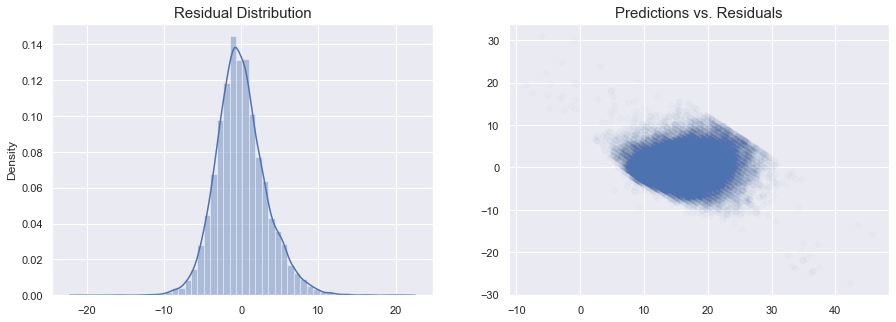

In [559]:
fig = plt.figure(1, figsize=(15,5))
axis = fig.add_subplot(1,2,1)
ax1 = sns.distplot(fit2.resid)
plt.title('Residual Distribution', size=15);
axis = fig.add_subplot(1,2,2)
plt.scatter(fit1.predict(), fit1.resid, alpha = 0.02);
plt.title('Predictions vs. Residuals', size=15);

In [560]:
std = StandardScaler() 
std.fit(x_test.values) 
X_train_scaled = std.transform(x_test.values)
model = sm.OLS(y_test, sm.add_constant(X_train_scaled))

fit2 = model.fit()
fit2.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                taxiout   R-squared:                       0.629
Model:                            OLS   Adj. R-squared:                  0.624
Method:                 Least Squares   F-statistic:                     123.1
Date:                Thu, 10 Dec 2020   Prob (F-statistic):               0.00
Time:                        23:27:01   Log-Likelihood:                -25561.
No. Observations:                9786   AIC:                         5.139e+04
Df Residuals:                    9652   BIC:                         5.235e+04
Df Model:                         133                                         
Covariance Type:            nonrobust                                         
==============================================================================
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const         15.1124      0.034    450.322      0.000      15.047      15.178
x1             0.0782      0.048      1.646      0.100      -0.015       0.171
x2             0.2809      0.126      2.234      0.026       0.034       0.527
x3             0.1180      0.118      1.002      0.316      -0.113       0.349
x4           -26.9936      0.496    -54.471      0.000     -27.965     -26.022
x5            -2.5414      0.046    -55.379      0.000      -2.631      -2.451
x6           -14.6681      0.178    -82.307      0.000     -15.017     -14.319
x7            15.6038      0.183     85.204      0.000      15.245      15.963
x8             0.5981      0.042     14.149      0.000       0.515       0.681
x9            -0.0094      0.071     -0.132      0.895      -0.149       0.130
x10            0.1487      0.040      3.687      0.000       0.070       0.228
x11            0.2312      0.195      1.187      0.235      -0.150       0.613
x12            0.0102      0.109      0.093      0.926      -0.203       0.223
x13           -0.3330      0.140     -2.372      0.018      -0.608      -0.058
x14            0.0285      0.072      0.395      0.693      -0.113       0.170
x15           -0.0376      0.071     -0.528      0.597      -0.177       0.102
x16            0.1225      0.120      1.018      0.309      -0.113       0.358
x17           -0.1149      0.120     -0.955      0.340      -0.351       0.121
x18        -6.138e-16   1.41e-16     -4.346      0.000   -8.91e-16   -3.37e-16
x19            1.8817      0.051     36.763      0.000       1.781       1.982
x20         1.402e-14   8.33e-16     16.836      0.000    1.24e-14    1.57e-14
x21         3.478e-14   9.65e-16     36.029      0.000    3.29e-14    3.67e-14
x22        -4.898e-14   9.76e-16    -50.187      0.000   -5.09e-14   -4.71e-14
x23        -1.733e-14   8.68e-16    -19.955      0.000    -1.9e-14   -1.56e-14
x24          4.75e-14   1.33e-15     35.767      0.000    4.49e-14    5.01e-14
x25         2.488e-14   6.24e-16     39.890      0.000    2.37e-14    2.61e-14
x26           -0.2157      0.050     -4.274      0.000      -0.315      -0.117
x27        -5.506e-15   2.61e-16    -21.104      0.000   -6.02e-15   -4.99e-15
x28            2.7306      0.066     41.535      0.000       2.602       2.859
x29         2.928e-14   7.54e-16     38.837      0.000    2.78e-14    3.08e-14
x30        -4.305e-14   7.41e-16    -58.062      0.000   -4.45e-14   -4.16e-14
x31          4.59e-14   8.95e-16     51.290      0.000    4.41e-14    4.77e-14
x32          9.74e-14   1.69e-15     57.708      0.000    9.41e-14    1.01e-13
x33            3.5484      0.074     47.902      0.000       3.403       3.694
x34           -3.4339      0.071    -48.124      0.000      -3.574      -3.294
x35         9.582e-15   4.51e-16     21.253      0.000     8.7e-15    1.05e-14
x3

C:\Users\cutem\Anaconda3\lib\site-packages\seaborn\distributions.py:2551: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


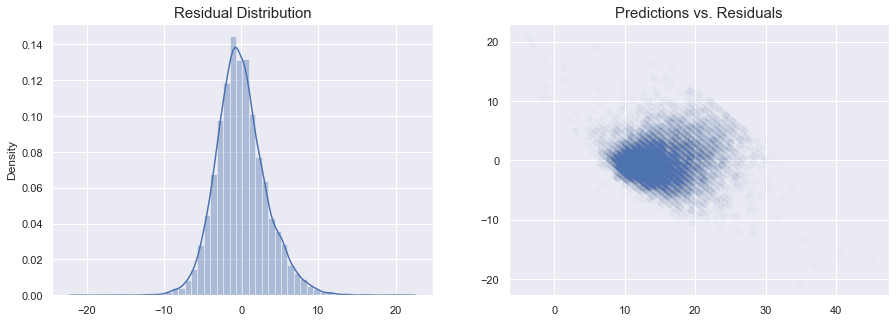

In [561]:
fig = plt.figure(1, figsize=(15,5))
axis = fig.add_subplot(1,2,1)
ax1 = sns.distplot(fit2.resid)
plt.title('Residual Distribution', size=15);
axis = fig.add_subplot(1,2,2)
plt.scatter(fit2.predict(), fit2.resid, alpha = 0.02);
plt.title('Predictions vs. Residuals', size=15);

In [562]:
profile 